# Exploratory Data Analysis

In [1]:
# import packages
import os
import pprint
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn import preprocessing 
import seaborn as sns
from tqdm import tqdm
from IPython.display import display

# pandas display options
pd.set_option('display.max_columns', 150)
pd.set_option('display.max_rows', 300)
pd.set_option('float_format', '{:,.2f}'.format) # All float will be displayed in 2 d.p. with comma to separate thousands

In [2]:
# datasets paths
path = "data"
macro = os.path.join(path, "macro.csv")
train = os.path.join(path, "train.zip")
test = os.path.join(path,  "test.zip")

# place all datasets paths in a datasets dict
datasets = {}
datasets['macro'] = macro
datasets['train'] = train
datasets['test'] = test

# load dataframes into dfs dict
dfs = {}
for dataset_name, path in datasets.items():
    df = pd.read_csv(path)
    dfs[dataset_name] = df

# assign to own df variables when you want to use them individually
df_macro = dfs['macro']
df_train = dfs['train']
df_test = dfs['test']

## Overview of datasets

**Dataset size & Number of distinct datatypes**

In [3]:
for dataset_name, df in dfs.items():
    print("====== Dataset size - {}: {} ======".format(dataset_name , df.shape))
    print("Number of distinct datatypes: \n{}".format(df.dtypes.map(type).value_counts()))

====== Dataset size - macro: (2484, 100) ======
Number of distinct datatypes: 
<class 'numpy.dtype[float64]'>    94
<class 'numpy.dtype[object_]'>     4
<class 'numpy.dtype[int64]'>       2
dtype: int64
====== Dataset size - train: (30471, 292) ======
Number of distinct datatypes: 
<class 'numpy.dtype[int64]'>      157
<class 'numpy.dtype[float64]'>    119
<class 'numpy.dtype[object_]'>     16
dtype: int64
====== Dataset size - test: (7662, 291) ======
Number of distinct datatypes: 
<class 'numpy.dtype[int64]'>      159
<class 'numpy.dtype[float64]'>    116
<class 'numpy.dtype[object_]'>     16
dtype: int64


**Display top 5 rows for dataset**

In [4]:
for dataset_name, df in dfs.items():
    print("Display top 5 rows for dataset: {}".format(dataset_name))
    display(df.head(5))

Display top 5 rows for dataset: macro


,timestamp,oil_urals,gdp_quart,gdp_quart_growth,cpi,ppi,gdp_deflator,balance_trade,balance_trade_growth,usdrub,eurrub,brent,net_capital_export,gdp_annual,gdp_annual_growth,average_provision_of_build_contract,average_provision_of_build_contract_moscow,rts,micex,micex_rgbi_tr,micex_cbi_tr,deposits_value,deposits_growth,deposits_rate,mortgage_value,mortgage_growth,mortgage_rate,grp,grp_growth,income_per_cap,real_dispos_income_per_cap_growth,salary,salary_growth,fixed_basket,retail_trade_turnover,retail_trade_turnover_per_cap,retail_trade_turnover_growth,labor_force,unemployment,employment,invest_fixed_capital_per_cap,invest_fixed_assets,profitable_enterpr_share,unprofitable_enterpr_share,share_own_revenues,overdue_wages_per_cap,fin_res_per_cap,marriages_per_1000_cap,divorce_rate,construction_value,invest_fixed_assets_phys,pop_natural_increase,pop_migration,pop_total_inc,childbirth,mortality,housing_fund_sqm,lodging_sqm_per_cap,water_pipes_share,baths_share,sewerage_share,gas_share,hot_water_share,electric_stove_share,heating_share,old_house_share,average_life_exp,infant_mortarity_per_1000_cap,perinatal_mort_per_1000_cap,incidence_population,rent_price_4+room_bus,rent_price_3room_bus,rent_price_2room_bus,rent_price_1room_bus,rent_price_3room_eco,rent_price_2room_eco,rent_price_1room_eco,load_of_teachers_preschool_per_teacher,child_on_acc_pre_school,load_of_teachers_school_per_teacher,students_state_oneshift,modern_education_share,old_education_build_share,provision_doctors,provision_nurse,load_on_doctors,power_clinics,hospital_beds_available_per_cap,hospital_bed_occupancy_per_year,provision_retail_space_sqm,provision_retail_space_modern_sqm,turnover_catering_per_cap,theaters_viewers_per_1000_cap,seats_theather_rfmin_per_100000_cap,museum_visitis_per_100_cap,bandwidth_sports,population_reg_sports_share,students_reg_sports_share,apartment_build,apartment_fund_sqm
0,2010-01-01,76.10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"38,807.20",-0.08,5.00,NaN,NaN,NaN,NaN,NaN,7484970,NaN,NaN,142968,NaN,13.72,"8,375.86",NaN,"30,789.20",0.04,"38,410.50",NaN,"11,443.63","2,882.42",251.48,106.80,"6,436.24",0.02,0.69,"63,932.00",732.76,0.72,0.28,0.96,"12,865.00",233.35,8.00,3.90,"553,874.90",95.80,-0.30,14.10,13.80,10.70,11.00,216.00,18.72,99.90,99.80,99.60,44.40,95.70,55.00,99.90,0.30,74.20,6.10,5.87,696.60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,721.48,"45,713","1,356.11",NaN,NaN,NaN,18.00,99.40,"7,872.85",162.90,NaN,NaN,NaN,690.00,"6,221.00",527.00,0.41,993.00,NaN,NaN,63.03,"22,825.00",NaN
1,2010-01-02,76.10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"38,807.20",-0.08,5.00,NaN,NaN,NaN,NaN,175.15,7484970,NaN,NaN,142968,NaN,13.72,"8,375.86",NaN,"30,789.20",0.04,"38,410.50",NaN,"11,443.63","2,882.42",251.48,106.80,"6,436.24",0.02,0.69,"63,932.00",732.76,0.72,0.28,0.96,"12,865.00",233.35,8.00,3.90,"553,874.90",95.80,-0.30,14.10,13.80,10.70,11.00,216.00,18.72,99.90,99.80,99.60,44.40,95.70,55.00,99.90,0.30,74.20,6.10,5.87,696.60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,721.48,"45,713","1,356.11",NaN,NaN,NaN,18.00,99.40,"7,872.85",162.90,NaN,NaN,NaN,690.00,"6,221.00",527.00,0.41,993.00,NaN,NaN,63.03,"22,825.00",NaN
2,2010-01-03,76.10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"38,807.20",-0.08,5.00,NaN,NaN,NaN,NaN,178.66,7484970,NaN,NaN,142968,NaN,13.72,"8,375.86",NaN,"30,789.20",0.04,"38,410.50",NaN,"11,443.63","2,882.42",251.48,106.80,"6,436.24",0.02,0.69,"63,932.00",732.76,0.72,0.28,0.96,"12,865.00",233.35,8.00,3.90,"553,874.90",95.80,-0.30,14.10,13.80,10.70,11.00,216.00,18.72,99.90,99.80,99.60,44.40,95.70,55.00,99.90,0.30,74.20,6.10,5.87,696.60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,721.48,"45,713","1,356.11",NaN,NaN,NaN,18.00,99.40,"7,872.85",162.90,NaN,NaN,NaN,690.00,"6,221.00",527.00,0.41,993.00,NaN,NaN,63.03,"22,825.00",NaN
3,2010-01-04,76.10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.91,43.41,80.12,NaN,"38,807.20",-0.08,5.00,NaN,NaN,NaN,NaN,183.44,7484970,NaN,NaN,142968,NaN,13.72,"8,375.86",NaN,"30,789.20",0.04,"38,410.50",NaN,"11,443.63","2,882.42",251.48,106.80,"6,436.24",0.02,0.69,"6

Display top 5 rows for dataset: train


,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,office_raion,thermal_power_plant_raion,incineration_raion,oil_chemistry_raion,radiation_raion,railroad_terminal_raion,big_market_raion,nuclear_reactor_raion,detention_facility_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,...,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_avg_price_2000,cafe_count_2000_na_price,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,mosque_count_2000,leisure_count_2000,sport_count_2000,market_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_avg_price_3000,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,church_count_3000,mosque_count_3000,leisure_count_3000,sport_count_3000,market_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_min_price_avg,cafe_sum_5000_max_price_avg,cafe_avg_price_5000,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,big_church_count_5000,church_count_5000,mosque_count_5000,leisure_count_5000,sport_count_5000,market_count_5000,price_doc
0,1,2011-08-20,43,27.00,4.00,NaN,NaN,NaN,NaN,NaN,NaN,Investment,Bibirevo,"6,407,578.10",155572,0.19,0.00,9576,"5,001.00",5,10309,"11,065.00",5,0,240.00,1,0,7,3,no,0,16,1,no,no,no,no,no,no,no,no,86206,40477,45729,21154,11007,10147,98207,52277,45930,36211,10580,25631,9576,4899,4677,10309,5463,4846,23603,12286,11317,17508,9425,8083,18654,9709,8945,211.00,25.00,0.00,0.00,0.00,2.00,184.00,...,2,0,0,7,1,11.77,15.97,9,188854,19,1244891,36,614.29,"1,042.86",828.57,1,15,11,6,2,1,0,1,2,0,0,10,1,11.98,13.55,12,251554,23,1419204,68,639.68,"1,079.37",859.52,5,21,22,16,3,1,0,2,4,0,0,21,1,13.09,13.31,29,807385,52,4036616,152,708.57,"1,185.71",947.14,12,39,48,40,9,4,0,13,22,1,0,52,4,5850000
1,2,2011-08-23,34,19.00,3.00,NaN,NaN,NaN,NaN,NaN,NaN,Investment,Nagatinskij Zaton,"9,589,336.91",115352,0.37,0.05,6880,"3,119.00",5,7759,"6,237.00",8,0,229.00,1,0,6,1,yes,1,3,0,no,no,no,no,no,no,no,no,76284,34200,42084,15727,7925,7802,70194,35622,34572,29431,9266,20165,6880,3466,3414,7759,3909,3850,17700,8998,8702,15164,7571,7593,13729,6929,6800,245.00,83.00,1.00,0.00,67.00,4.00,90.00,...,5,0,4,9,0,22.37,19.25,4,165510,8,179065,21,695.24,"1,190.48",942.86,0,7,8,3,2,1,0,1,5,0,4,11,0,18.07,27.32,12,821986,14,491565,30,631.03,"1,086.21",858.62,1,11,11,4,2,1,0,1,7,0,6,19,1,10.26,27.47,66,2690465,40,2034942,177,673.81,"1,148.81",911.31

Display top 5 rows for dataset: test


,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,office_raion,thermal_power_plant_raion,incineration_raion,oil_chemistry_raion,radiation_raion,railroad_terminal_raion,big_market_raion,nuclear_reactor_raion,detention_facility_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,...,big_church_count_1500,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_avg_price_2000,cafe_count_2000_na_price,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,mosque_count_2000,leisure_count_2000,sport_count_2000,market_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_avg_price_3000,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,church_count_3000,mosque_count_3000,leisure_count_3000,sport_count_3000,market_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_min_price_avg,cafe_sum_5000_max_price_avg,cafe_avg_price_5000,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,big_church_count_5000,church_count_5000,mosque_count_5000,leisure_count_5000,sport_count_5000,market_count_5000
0,30474,2015-07-01,39.00,20.70,2,9,1,"1,998.00",1,8.90,3.00,Investment,Juzhnoe Butovo,"26,155,137.04",178264,0.14,0.04,14080,"11,926.00",11,14892,"24,750.00",13,1,NaN,1,0,13,4,no,0,4,4,no,no,no,no,no,no,no,no,102618,47681,54937,30808,16251,14557,121369,59138,62231,26087,7410,18677,14080,7457,6623,14892,7839,7053,34341,18094,16247,19906,9676,10230,27123,14340,12783,"1,681.00",173.00,607.00,19.00,245.00,116.00,431.00,...,1,2,0,0,4,0,15.17,1.18,0,0,0,0,3,"1,000.00","1,500.00","1,250.00",0,0,0,3,0,0,0,1,2,1,0,5,0,14.69,2.87,0,0,3,73000,12,781.82,"1,227.27","1,004.55",1,2,2,7,0,0,0,1,3,1,0,7,0,21.58,4.69,1,37550,8,299166,19,676.47,"1,088.24",882.35,2,5,4,8,0,0,0,1,10,1,0,14,1
1,30475,2015-07-01,79.20,NaN,8,17,1,0.00,3,1.00,1.00,OwnerOccupier,Poselenie Vnukovskoe,"25,536,296.81",4001,0.50,0.01,275,NaN,0,264,NaN,0,0,NaN,0,0,0,0,no,0,1,0,no,no,no,no,no,no,no,no,17790,8350,9443,574,297,277,2566,1356,1211,861,244,617,275,143,133,264,136,128,646,336,311,3796,2035,1762,506,261,245,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0,1,0,0,1,0,49.26,4.06,0,0,1,5000,7,757.14,"1,285.71","1,021.43",0,1,3,2,1,0,0,1,2,0,0,1,0,39.50,3.32,0,0,2,22000,10,680.00,"1,200.00",940.00,0,1,6,2,1,0,0,1,5,0,0,7,0,39.10,7.70,2,177300,6,231300,20,733.33,"1,250.00",991.67,2,4,8,4,1,1,0,2,11,0,1,12,1
2,30476,2015-07-01,40.50,25.10,3,5,2,"1,9

**Display descriptive statistics for dataset**

In [5]:
for dataset_name, df in dfs.items():
    print("Display descriptive statistics for dataset: {}".format(dataset_name))
    display(df.describe())

Display descriptive statistics for dataset: macro


,oil_urals,gdp_quart,gdp_quart_growth,cpi,ppi,gdp_deflator,balance_trade,balance_trade_growth,usdrub,eurrub,brent,net_capital_export,gdp_annual,gdp_annual_growth,average_provision_of_build_contract,average_provision_of_build_contract_moscow,rts,micex,micex_rgbi_tr,micex_cbi_tr,deposits_value,deposits_growth,deposits_rate,mortgage_value,mortgage_growth,mortgage_rate,grp,grp_growth,income_per_cap,real_dispos_income_per_cap_growth,salary,salary_growth,fixed_basket,retail_trade_turnover,retail_trade_turnover_per_cap,retail_trade_turnover_growth,labor_force,unemployment,employment,invest_fixed_capital_per_cap,invest_fixed_assets,profitable_enterpr_share,unprofitable_enterpr_share,share_own_revenues,overdue_wages_per_cap,fin_res_per_cap,marriages_per_1000_cap,divorce_rate,construction_value,invest_fixed_assets_phys,pop_natural_increase,pop_migration,pop_total_inc,childbirth,mortality,housing_fund_sqm,lodging_sqm_per_cap,water_pipes_share,baths_share,sewerage_share,gas_share,hot_water_share,electric_stove_share,heating_share,old_house_share,average_life_exp,infant_mortarity_per_1000_cap,perinatal_mort_per_1000_cap,incidence_population,rent_price_4+room_bus,rent_price_3room_bus,rent_price_2room_bus,rent_price_1room_bus,rent_price_3room_eco,rent_price_2room_eco,rent_price_1room_eco,load_of_teachers_preschool_per_teacher,load_of_teachers_school_per_teacher,students_state_oneshift,provision_doctors,provision_nurse,load_on_doctors,power_clinics,hospital_beds_available_per_cap,hospital_bed_occupancy_per_year,provision_retail_space_sqm,provision_retail_space_modern_sqm,turnover_catering_per_cap,theaters_viewers_per_1000_cap,seats_theather_rfmin_per_100000_cap,museum_visitis_per_100_cap,bandwidth_sports,population_reg_sports_share,students_reg_sports_share,apartment_build,apartment_fund_sqm
count,"2,484.00","2,394.00","2,394.00","2,453.00","2,453.00","2,119.00","2,453.00","2,394.00","2,481.00","2,481.00","2,481.00","2,088.00","2,484.00","2,484.00","2,484.00","2,119.00","2,474.00","2,474.00","2,474.00","2,483.00","2,484.00","2,453.00","2,070.00","2,484.00","2,119.00","2,484.00","1,826.00","1,461.00","2,191.00","1,826.00","2,191.00","1,826.00","2,484.00","2,191.00","2,191.00","2,191.00","2,191.00","2,191.00","2,191.00","2,191.00","2,191.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","2,191.00","1,826.00","1,826.00","2,191.00","2,191.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","1,826.00","2,191.00","1,826.00","1,826.00","1,826.00","2,211.00","2,211.00","2,211.00","2,211.00","2,211.00","2,211.00","2,211.00","1,461.00","2,191.00","1,826.00","1,826.00","2,191.00","2,191.00","1,826.00","1,461.00","1,461.00",731.00,730.00,"2,191.00","1,461.00","2,191.00","1,461.00","1,826.00","1,461.00","1,461.00","1,826.00","1,826.00"
mean,86.47,"16,993.23",1.52,407.81,480.22,110.12,15.34,16.85,40.73,50.44,88.18,-0.04,"62,557.07",0.01,5.77,6.56,"1,314.54","1,553.80",129.03,233.73,"15,041,696.69",0.01,6.30,"500,798.07",0.43,12.66,"10,722.96",0.11,"51,766.24",-0.00,"52,188.93",0.11,"15,331.50","3,767.97",315.64,100.63,"6,818.98",0.01,0.72,"102,647.82","1,229.29",0.69,0.31,0.95,"51,196.61",200.78,8.12,3.76,"624,322.88",108.55,1.19,8.56,9.66,11.16,9.96,226.40,19.04,99.24,99.08,98.64,43.86,94.88,54.82,99.54,0.36,75.93,6.82,7.61,691.36,166.75,95.23,72.05,52.87,47.30,38.90,31.00,808.76,"1,455.17",94.34,55.25,96.17,"7,983.72",171.59,790.28,294.75,767.54,480.50,"8,691.92",580.52,0.44,"1,245.54","349,902.58",25.07,67.80,"36,282.43","230,615.06"
std,27.53,"3,187.07",2.88,65.90,70.29,14.82,3.88,16.99,15.01,13.91,26.96,0.27,"14,503.68",0.04,0.54,0.45,334.60,180.79,7.10,35.58,"4,762,312.34",0.02,1.90,"394,604.98",0.48,0.66,"1,526.66",0.05,"13,310.71",0.05,"9,068.56",0.04,"2,789.14",548.17,38.93,8.21,229.13,0.00,0.02,"25,659.13",332.48,0.02,0.02,0.03,"22,888.86",54.52,0.25,0.10,"71,437.48",12.99,0.70,3.20,2.69,0.30,0.48,7.76,0.24,0.54,0.59,0.74,0.38,0.67,0.45,0.29,0.

Display descriptive statistics for dataset: train


,id,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25_raion,shopping_centers_raion,office_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_foam,build_count_slag,build_count_mix,raion_build_count_with_builddate_info,build_count_before_1920,build_count_1921-1945,build_count_1946-1970,build_count_1971-1995,build_count_after_1995,ID_metro,metro_min_avto,metro_km_avto,...,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_avg_price_2000,cafe_count_2000_na_price,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,mosque_count_2000,leisure_count_2000,sport_count_2000,market_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_avg_price_3000,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,church_count_3000,mosque_count_3000,leisure_count_3000,sport_count_3000,market_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_min_price_avg,cafe_sum_5000_max_price_avg,cafe_avg_price_5000,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,big_church_count_5000,church_count_5000,mosque_count_5000,leisure_count_5000,sport_count_5000,market_count_5000,price_doc
count,"30,471.00","30,471.00","24,088.00","30,304.00","20,899.00","20,899.00","16,866.00","20,899.00","20,899.00","16,912.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","23,783.00","30,471.00","30,471.00","23,786.00","30,471.00","30,471.00","16,030.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","25,480.00","30,471.00","30,471.00","30,471.00",...,"30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","28,746.00","28,746.00","28,746.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","30,471.00","

Display descriptive statistics for dataset: test


,id,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25_raion,shopping_centers_raion,office_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_foam,build_count_slag,build_count_mix,raion_build_count_with_builddate_info,build_count_before_1920,build_count_1921-1945,build_count_1946-1970,build_count_1971-1995,build_count_after_1995,ID_metro,metro_min_avto,metro_km_avto,...,big_church_count_1500,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_avg_price_2000,cafe_count_2000_na_price,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,mosque_count_2000,leisure_count_2000,sport_count_2000,market_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_avg_price_3000,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,church_count_3000,mosque_count_3000,leisure_count_3000,sport_count_3000,market_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_min_price_avg,cafe_sum_5000_max_price_avg,cafe_avg_price_5000,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,big_church_count_5000,church_count_5000,mosque_count_5000,leisure_count_5000,sport_count_5000,market_count_5000
count,"7,662.00","7,662.00","6,486.00","7,662.00","7,662.00","7,662.00","6,613.00","7,662.00","7,662.00","6,968.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","6,066.00","7,662.00","7,662.00","6,067.00","7,662.00","7,662.00","4,244.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","6,444.00","7,662.00","7,662.00","7,662.00",...,"7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,643.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,238.00","7,238.00","7,238.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,662.00","7,480.00","7,480.00","7,480.00","7,662.00","7,662.00","7,662.00

## Check for Missing Values

In [6]:
# calculate the raw number of cols w/ missing values
missing_values_raw = df_train.isna().sum()

# calculate the percentage of cols w/ missing values (round to 2 d.p.)
missing_values_percentage = round(((df_train.isna().sum()) / df_train.shape[0]) * 100, 2)

# concat both series, rename col names, set index name, sort by descending order
merged_missing_values = pd.concat([missing_values_raw, missing_values_percentage], axis=1)
merged_missing_values.rename(columns={0: "Raw", 1: "Percentage"}, inplace=True)
merged_missing_values.index.name = 'Variables'
merged_missing_values.reset_index(inplace=True)
merged_missing_values.sort_values(by=['Raw'], ascending=False, inplace=True)

# # get number of cols w/ missing values
num_missing_values_col = (merged_missing_values['Raw'] != 0).sum()

# # display only those n cols w/ missing values
print("Number of columns with missing values: {}".format(num_missing_values_col))
df_missing_values = merged_missing_values[merged_missing_values['Raw'].values != 0]
display(df_missing_values)

Number of columns with missing values: 51


,Variables,Raw,Percentage
24,hospital_beds_raion,14441,47.39
7,build_year,13605,44.65
10,state,13559,44.50
162,cafe_avg_price_500,13281,43.59
161,cafe_sum_500_max_price_avg,13281,43.59
160,cafe_sum_500_min_price_avg,13281,43.59
5,max_floor,9572,31.41
6,material,9572,31.41
8,num_room,9572,31.41
9,kitch_sq,9572,31.41


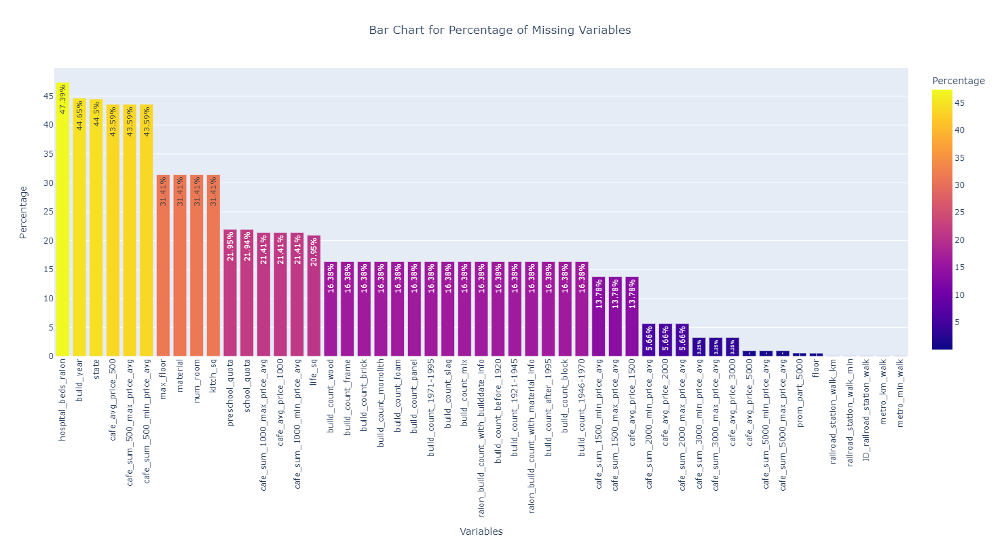

In [7]:
# plot the bar chart of cols w/ missing values
fig = px.bar(df_missing_values, x='Variables', y='Percentage', hover_data=['Raw'], text='Percentage', color='Percentage', title='Bar Chart for Percentage of Missing Variables', width=1600, height=800)  
fig.update_layout(title_x=0.5) # centralize title
fig.update_xaxes(tickangle=-90) # rotate x label 90 deg so its easier to see
fig.update_traces(texttemplate='%{text:,}%', textposition='inside',  textangle=-90) # add text overlay to display values
fig.show()

## Univariate Analysis for target variable `price_doc`

In [8]:
df_train['price_doc'].describe()

count        30,471.00
mean      7,123,035.28
std       4,780,111.33
min         100,000.00
25%       4,740,002.00
50%       6,274,411.00
75%       8,300,000.00
max     111,111,112.00
Name: price_doc, dtype: float64

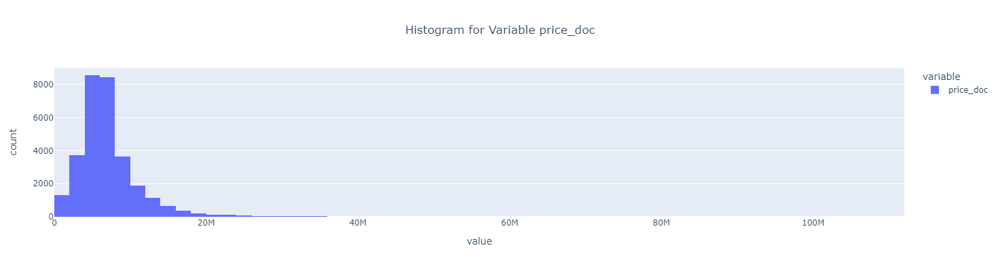

In [9]:
# Histogram for price_doc
fig = px.histogram(df_train['price_doc'], nbins=100, title='Histogram for Variable price_doc', width=600, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

In [10]:
range(df_train.shape[0])

range(0, 30471)

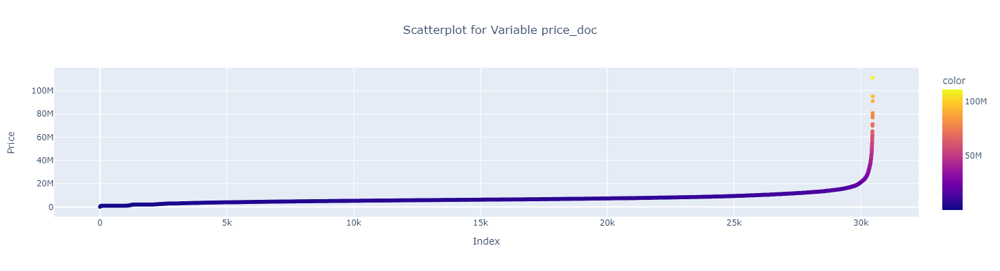

In [11]:
# Scatterplot for price_doc
fig = px.scatter(df, x=list(range(df_train.shape[0])), y=np.sort(df_train['price_doc'].values), color=np.sort(df_train['price_doc'].values), title='Scatterplot for Variable price_doc', width=600, height=400)
fig.update_layout(title_x=0.5,
                  xaxis_title="Index",
                  yaxis_title="Price")
fig.show()

**Check out the top 5 most expensive houses**

In [12]:
# Top 5 most expensive houses - Teplyj Stan sub area has most expensive house
df_train.nlargest(5, 'price_doc')

,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,office_raion,thermal_power_plant_raion,incineration_raion,oil_chemistry_raion,radiation_raion,railroad_terminal_raion,big_market_raion,nuclear_reactor_raion,detention_facility_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,...,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_avg_price_2000,cafe_count_2000_na_price,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,mosque_count_2000,leisure_count_2000,sport_count_2000,market_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_avg_price_3000,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,church_count_3000,mosque_count_3000,leisure_count_3000,sport_count_3000,market_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_min_price_avg,cafe_sum_5000_max_price_avg,cafe_avg_price_5000,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,big_church_count_5000,church_count_5000,mosque_count_5000,leisure_count_5000,sport_count_5000,market_count_5000,price_doc
2118,2121,2012-05-10,55,31.00,12.00,NaN,NaN,NaN,NaN,NaN,NaN,Investment,Teplyj Stan,"8,392,316.21",130396,0.43,0.00,6980,"4,523.00",5,7614,"9,443.00",6,0,NaN,1,0,3,2,no,0,5,3,no,no,no,yes,no,yes,no,no,90114,47893,42221,15541,7898,7643,76776,38310,38466,38079,12885,25194,6980,3496,3484,7614,3917,3697,17425,8832,8593,20655,10812,9843,13682,6913,6769,195.00,53.00,0.00,0.00,3.00,8.00,131.00,...,5,0,1,5,0,47.25,0.06,3,90893,2,82800,28,757.69,"1,250.00","1,003.85",2,9,5,7,5,0,0,1,9,0,1,10,0,35.51,4.76,7,145488,11,355700,70,704.55,"1,189.39",946.97,4,20,21,15,10,0,0,3,15,0,1,25,0,24.68,14.26,29,781653,42,1253571,177,669.70,"1,133.33",901.52,12,50,57,40,18,0,0,6,28,1,4,48,8,111111112
28326,28329,2015-03-12,220,144.00,3.00,5.00,2.00,"1,927.00",9.00,17.00,3.00,Investment,Presnenskoe,"11,638,050.15",123280,0.07,0.04,7125,"3,240.00",7,6856,"10,602.00",9,0,"1,940.00",2,1,29,2,yes,3,5,84,no,no,no,yes,no,no,no,no,57999,25611,32388,14906,7789,7117,75357,38841,36516,33017,10594,22423,7125,3725,3400,6856,3580,3276,16727,8746,7981,10184,4834,5350,13121,6880,6241,836.00,99.00,6.00,1.00,664.00,33.00,30.00,...,29,0,39,28,1,6.67,0.19,221,2124466,34,1303792,994,944.23,"1,551.82","1,248.02",58,241,230,221,157,72,15,40,60,0,49,50,2,6.86,1.54,424,4698954,49,1745942,1724,914.88,"1,504.34","1,209.61",111,419,399,406,258,111,20,77,

In [13]:
# Get descriptive statistics for houses prices for Teplyj Stan
df_train.price_doc[df_train.sub_area == 'Teplyj Stan'].describe()

count           165.00
mean      8,563,557.53
std       8,877,604.58
min         990,000.00
25%       6,200,000.00
50%       7,800,000.00
75%      10,000,000.00
max     111,111,112.00
Name: price_doc, dtype: float64

**Conclusion**
- This house with price_doc = 111,111,112 rubles is an outlier. Thus, there is no effect on the selling price. (?)
- Because the average price for houses in this sub area is 8,563,557 rubles.
- This training dataset has some outliers for houses from 80 million rubles onwards.

**Check out the bottom 5 most inexpensive houses**

In [14]:
# Bottom 5 most inexpensive houses - Teplyj Stan sub area has most expensive house
df_train.nsmallest(5, 'price_doc')

,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,office_raion,thermal_power_plant_raion,incineration_raion,oil_chemistry_raion,radiation_raion,railroad_terminal_raion,big_market_raion,nuclear_reactor_raion,detention_facility_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,...,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_avg_price_2000,cafe_count_2000_na_price,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,mosque_count_2000,leisure_count_2000,sport_count_2000,market_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_avg_price_3000,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,church_count_3000,mosque_count_3000,leisure_count_3000,sport_count_3000,market_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_min_price_avg,cafe_sum_5000_max_price_avg,cafe_avg_price_5000,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,big_church_count_5000,church_count_5000,mosque_count_5000,leisure_count_5000,sport_count_5000,market_count_5000,price_doc
20244,20247,2014-06-27,72,37.00,11.00,16.00,1.00,"2,006.00",2.00,12.00,1.00,Investment,Gol'janovo,"14,286,990.83",157010,0.39,0.19,7751,"5,041.00",6,8004,"11,081.00",7,0,125.00,3,0,5,3,no,0,5,3,no,no,no,yes,no,no,no,no,12327,5588,6739,16831,8637,8194,98260,47405,50855,41919,12424,29495,7751,3941,3810,8004,4152,3852,18912,9716,9196,2780,1351,1429,14694,7551,7143,371.00,88.00,0.00,0.00,68.00,8.00,207.00,...,1,0,0,2,0,36.15,4.89,1,2200,1,320000,6,520.00,900.00,710.00,1,2,2,1,0,0,0,2,1,0,0,4,1,31.02,8.10,4,179700,7,441142,20,621.05,"1,026.32",823.68,1,6,6,7,0,0,0,2,2,0,0,11,2,34.35,8.99,11,300476,15,505676,53,663.27,"1,122.45",892.86,4,15,18,12,3,1,0,5,8,0,2,30,5,100000
1167,1168,2012-02-11,38,23.00,9.00,NaN,NaN,NaN,NaN,NaN,NaN,Investment,Beskudnikovskoe,"3,292,112.22",73148,0.06,0.09,4449,"2,757.00",5,4346,"7,327.00",5,0,165.00,1,0,3,2,no,0,2,2,no,no,no,no,no,no,no,no,41504,18905,22599,9308,4847,4461,44449,22170,22279,19391,5955,13436,4449,2281,2168,4346,2283,2063,10271,5360,4911,9620,4575,5045,8322,4322,4000,222.00,97.00,0.00,0.00,4.00,13.00,108.00,...,2,0,0,6,1,7.38,17.90,4,89500,9,251900,32,958.06,"1,564.52","1,261.29",1,4,9,12,3,3,0,1,3,0,0,8,1,9.27,34.24,15,534307,16,638483,56,890.38,"1,480.77","1,185.58",4,6,20,17,5,4,0,4,6,0,0,20,2,14.00,20.56,40,932458,48,1503065,180,685.98,"1,155.49",920.73,16,4

## Bivariate Analysis on diff features against target variable `price_doc`

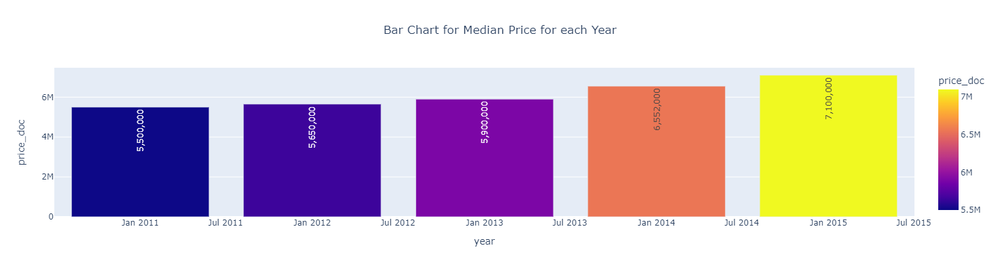

In [15]:
# plot the bar chart of median price for each year
# convert timestamp col to datetime format
df_train['timestamp'] = pd.to_datetime(df_train['timestamp'])
df_train['year'] = df_train['timestamp'].map(lambda x: x.year)

# convert to df, datetime year format to display properly
median_price = df_train.price_doc.groupby(df_train.year).median().to_frame()
median_price.reset_index(inplace=True)
median_price['year'] =  pd.to_datetime(median_price['year'], format='%Y')

fig = px.bar(median_price, x='year', y='price_doc', text='price_doc', color='price_doc', title='Bar Chart for Median Price for each Year', width=500, height=400)  
fig.update_layout(title_x=0.5) # centralize title
fig.update_traces(texttemplate='%{text:,}', textposition='inside',  textangle=-90) # add text overlay to display values
fig.show()

**Conclusion:**
- There is a gradual increasing trend with housing prices over the years.

### Info #1: Find out which `sub_area` has highest & lowest `price_doc`

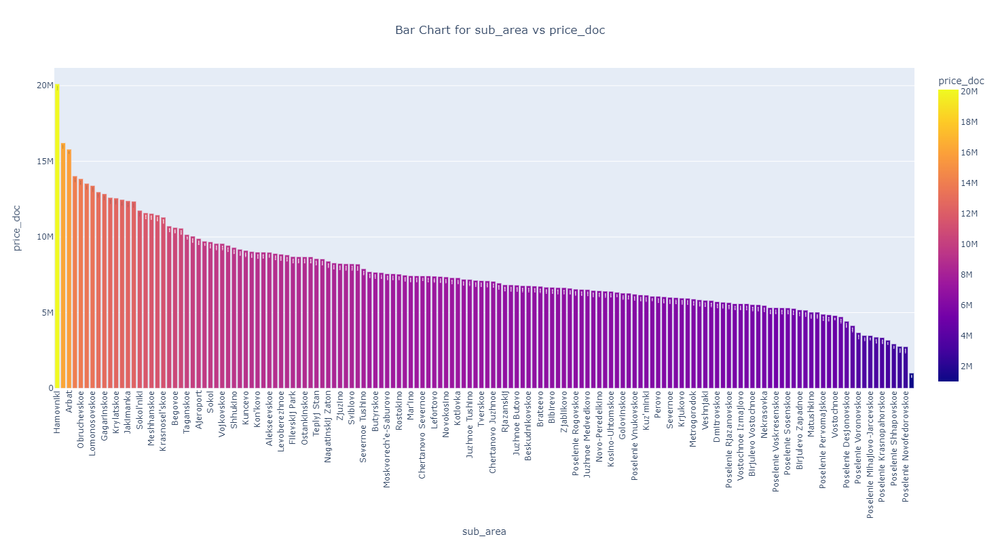

In [16]:
# plot the bar chart of sub_area vs price_doc
mean_price_groupby_sub_area = df_train['price_doc'].groupby(df_train['sub_area']).mean() # calc mean
mean_price_groupby_sub_area.sort_values(ascending=False, inplace=True) # sort in desc order

fig = px.bar(mean_price_groupby_sub_area, x=mean_price_groupby_sub_area.index, y='price_doc', text='price_doc', color='price_doc', title='Bar Chart for sub_area vs price_doc', width=1600, height=800)  
fig.update_layout(title_x=0.5) # centralize title
fig.update_xaxes(tickangle=-90) # rotate x label 90 deg so its easier to see
fig.update_traces(texttemplate='%{text:,}', textposition='inside',  textangle=-90) # add text overlay to display values
fig.show()

**Conclusion:**
- Highest: Hamovniki
- Lowest: Poselenie Klenovskoe

### Info #2: Average price in each `sub_area` by day

In [17]:
# agg based on sub_area and calc mean price_doc
df_train['day'] = df_train['timestamp'].map(lambda x: x.weekday())
df_train['day'].replace({0:'Monday', 1:'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'},inplace=True)
output = df_train.groupby([df_train['sub_area'], df_train['day']]).agg({'price_doc':lambda x: x.mean()})
# create df
idx_sub_area = df_train.sub_area.unique()
idx_sub_area.sort()
col = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
df_avg_price_by_district = pd.DataFrame(columns=col, index=idx_sub_area)
# build the df
for (idx, row) in df_avg_price_by_district.iterrows():
    temp = list(output.loc[idx].index)
    for i in col:
        if i not in temp:
            df_avg_price_by_district.loc[idx][i] = 0
        else:
            df_avg_price_by_district.loc[idx][i] = output.loc[idx].loc[i].values[0]

df_avg_price_by_district.index.name='Sub Area'
df_avg_price_by_district.reset_index(inplace=True)
df_avg_price_by_district.head(10)

,Sub Area,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,Ajeroport,"7,376,140.32","9,557,777.78","10,037,812.50","9,899,752.79","11,964,904.96","9,794,166.67","9,000,000.00"
1,Akademicheskoe,"9,665,771.71","11,788,400.00","10,618,815.12","10,564,204.77","10,295,507.05","10,559,937.50","11,300,000.00"
2,Alekseevskoe,"8,166,140.00","9,393,333.33","8,008,971.45","7,607,803.74","11,836,453.00","8,700,000.00",0
3,Altuf'evskoe,"3,628,076.92","6,676,666.67","6,018,208.85","5,636,363.64","5,781,818.18","4,790,000.00",0
4,Arbat,"26,824,000.00","16,150,000.00","10,630,000.00","12,850,000.00","15,100,000.00",0,0
5,Babushkinskoe,"7,187,815.43","7,127,481.00","6,780,714.00","6,989,074.74","8,986,629.62","9,338,672.64",0
6,Basmannoe,"10,151,327.21","14,096,813.33","10,466,958.82","11,129,115.21","12,544,859.20","8,573,750.00","9,000,000.00"
7,Begovoe,"11,212,500.00","10,619,230.77","12,505,555.56","10,871,101.27","7,680,000.00","8,466,666.67",0
8,Beskudnikovskoe,"6,493,478.26","6,278,103.45","7,022,968.55","6,593,939.39","7,816,071.43","5,885,833.33","4,500,000.00"
9,Bibirevo,"7,026,904.76","6,464,180.33","6,621,530.43","6,018,179.00","7,133,846.15","6,778,333.33",0


### Info #3: Relationship between `full_sq` and `price_doc`

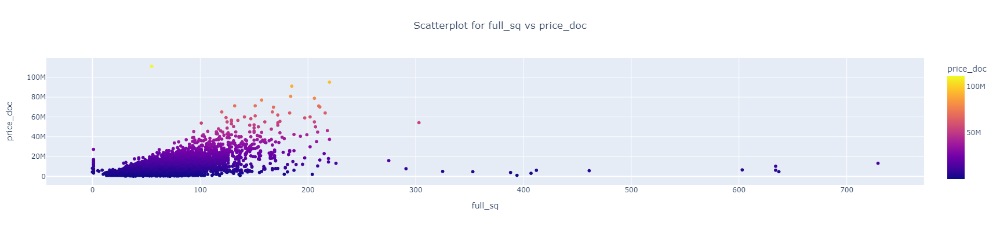

In [18]:
# remove the outlier
df = df_train[df_train['full_sq']<1000]
fig = px.scatter(df, x="full_sq", y="price_doc", color="price_doc", title='Scatterplot for full_sq vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

**Conclusion:**
- In general, as the square area of houses increases, the prices increases linearly.

### Info #4: Relationship between `green_zone_part` and `price_doc`

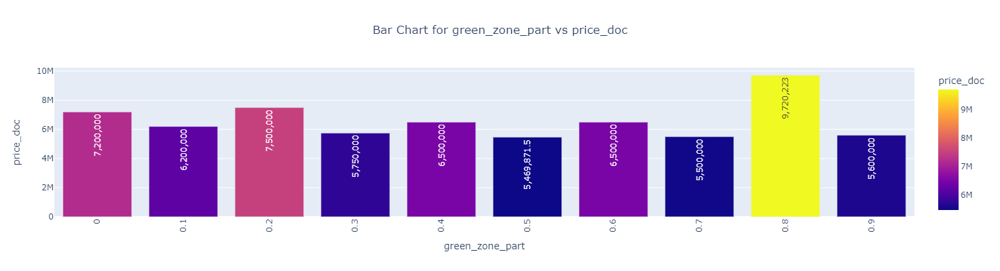

In [19]:
df = df_train.copy()
df['green_zone_part'] = df['green_zone_part'].round(1)
df_median = df['price_doc'].groupby(df['green_zone_part']).median()
df_median = df_median.to_frame()
df_median.reset_index(inplace=True)

fig = px.bar(df_median, x='green_zone_part', y='price_doc', text='price_doc', color='price_doc', title='Bar Chart for green_zone_part vs price_doc', width=600, height=400)  
fig.update_layout(title_x=0.5) # centralize title
fig.update_xaxes(tickangle=-90, type='category') # rotate x label 90 deg so its easier to see, change xaxis to be categorical type to display all
fig.update_traces(texttemplate='%{text:,}', textposition='inside',  textangle=-90) # add text overlay to display values
fig.show()

**Conclusion:**
- There is an outlier at green_zone_part = 0.8, where the price is the highest out of all.

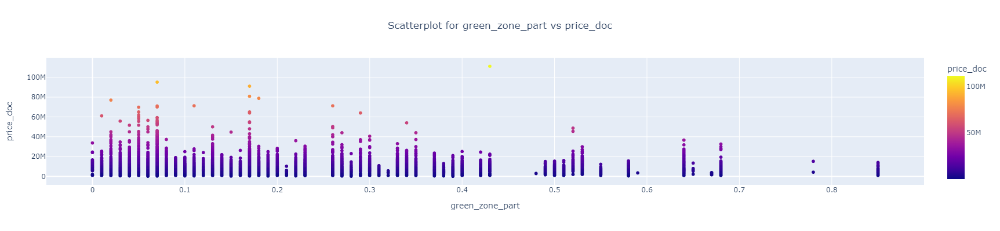

In [20]:
df = df_train.copy()
df['green_zone_part'] = df['green_zone_part'].round(2)
fig = px.scatter(df, x="green_zone_part", y="price_doc", color="price_doc", title='Scatterplot for green_zone_part vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

**Conclusion:**
- In general, as the distance between the house and green zone area increases, the price decreases. 

### Info #5: Relationship between `indust_part` and `price_doc`

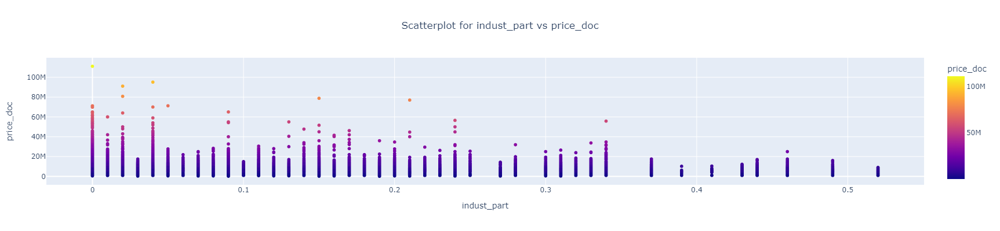

In [21]:
df = df_train.copy()
df['indust_part'] = df['indust_part'].round(2)
fig = px.scatter(df, x="indust_part", y="price_doc", color="price_doc", title='Scatterplot for indust_part vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

**Conclusion:**
- In general, if there is lesser share of industrial zones in the area, the prices are higher.

### Info #6: Relationship between `school_km` and `price_doc`

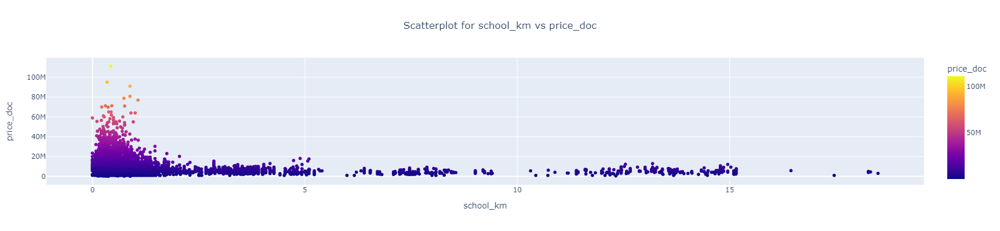

In [22]:
# remove outliers
data = df_train[df_train['school_km'] < 20]
fig = px.scatter(data, x="school_km", y="price_doc", color="price_doc", title='Scatterplot for school_km vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

### Info #7: Relationship between `public_healthcare_km` and `price_doc`

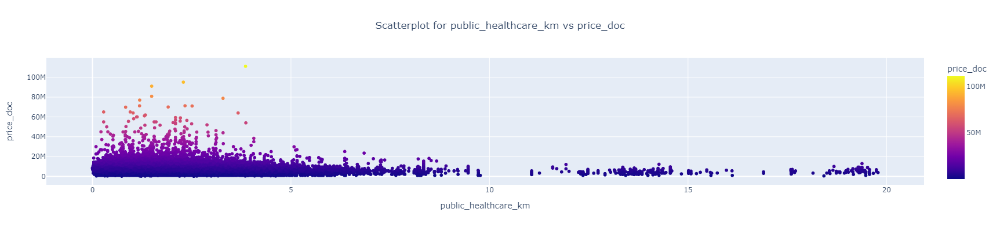

In [23]:
data = df_train[df_train['public_healthcare_km'] < 20]
fig = px.scatter(data, x="public_healthcare_km", y="price_doc", color="price_doc", title='Scatterplot for public_healthcare_km vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

### Info #8: Relationship between `shopping_centers_km` and `price_doc`

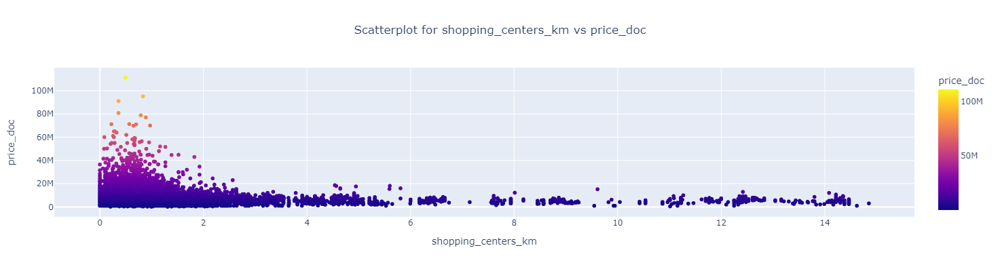

In [24]:
data = df_train[df_train['shopping_centers_km'] < 15]
fig = px.scatter(data, x="shopping_centers_km", y="price_doc", color="price_doc", title='Scatterplot for shopping_centers_km vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

**Conclusion:**
- In general, for houses with lesser distance from amenities like school, healthcare centres, and shopping centres, the higher the price.
- The price of house is directly proportional to distance to amenities.

### Info #9: Relationship between `swim_pool_km` and `price_doc`

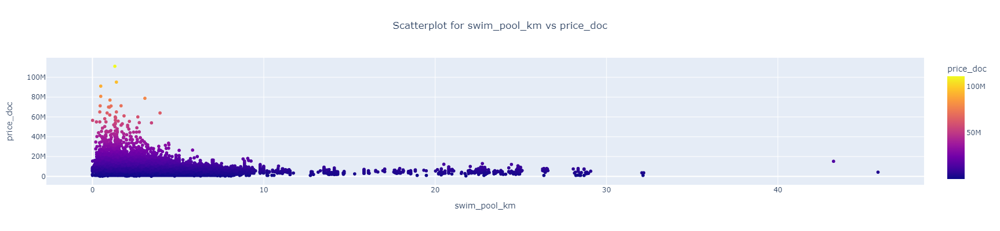

In [25]:
fig = px.scatter(data, x="swim_pool_km", y="price_doc", color="price_doc", title='Scatterplot for swim_pool_km vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

### Info #10: Relationship between `fitness_km` and `price_doc`

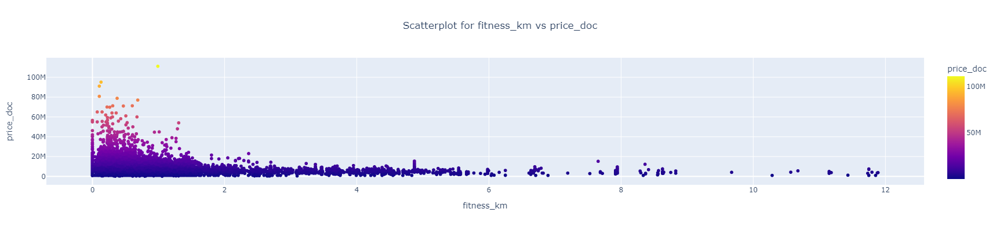

In [26]:
fig = px.scatter(data, x="fitness_km", y="price_doc", color="price_doc", title='Scatterplot for fitness_km vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

### Info #11: Relationship between `metro_km_walk` and `price_doc`

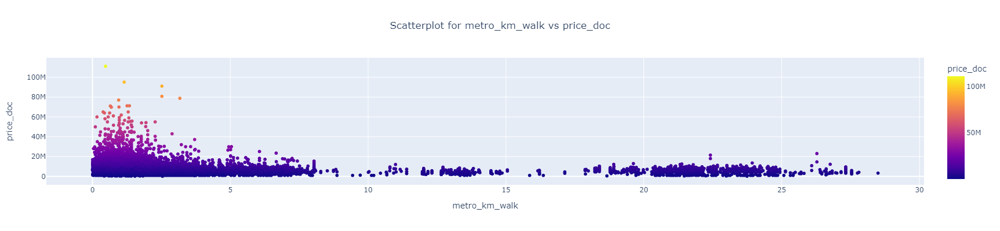

In [27]:
data = df_train[df_train['metro_km_walk'] < 30]
fig = px.scatter(data, x="metro_km_walk", y="price_doc", color="price_doc", title='Scatterplot for metro_km_walk vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

### Info #12: Relationship between `railroad_station_walk_km` and `price_doc`

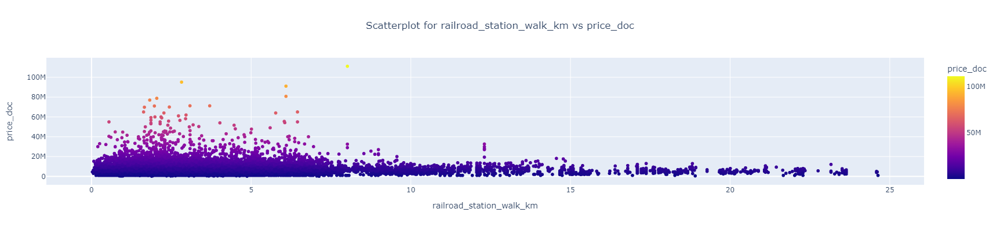

In [28]:
fig = px.scatter(data, x="railroad_station_walk_km", y="price_doc", color="price_doc", title='Scatterplot for railroad_station_walk_km vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

### Info #13: Relationship between `raion_popul` and `price_doc`

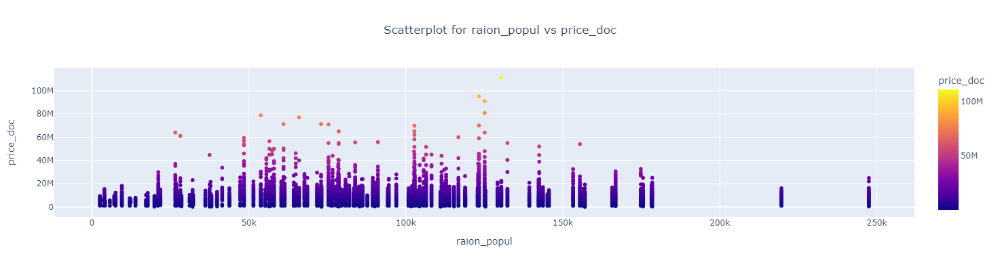

In [29]:
fig = px.scatter(data, x="raion_popul", y="price_doc", color="price_doc", title='Scatterplot for raion_popul vs price_doc', width=500, height=400)
fig.update_layout(title_x=0.5) # centralize title
fig.show()

**Conclusion:**
- In general, when the population in the area is too dense or low, the prices are lower.

### Info #14: Heatmap
The data which contains almost 300 columns is too large to visualize in one map. Thus, we divided the data into portions based on correlation value w.r.t. price.

#### Part 1: Analyze features with corr>=0.25 w.r.t. price

In [30]:
# get corr values
corr_vals = df_train.corr()
target_corr = abs(corr_vals["price_doc"])

# select features with high correlation with price
relevant_fts = target_corr[target_corr>=0.25]
print("Number of relevant features with corr >= 0.25: {}".format(len(relevant_fts)))
print(relevant_fts)

Number of relevant features with corr >= 0.25: 17
full_sq               0.34
num_room              0.48
sport_objects_raion   0.25
ttk_km                0.27
sadovoe_km            0.28
bulvar_ring_km        0.28
kremlin_km            0.28
zd_vokzaly_avto_km    0.28
nuclear_reactor_km    0.26
sport_count_1500      0.26
sport_count_2000      0.28
sport_count_3000      0.29
office_sqm_5000       0.27
trc_count_5000        0.29
trc_sqm_5000          0.27
sport_count_5000      0.29
price_doc             1.00
Name: price_doc, dtype: float64


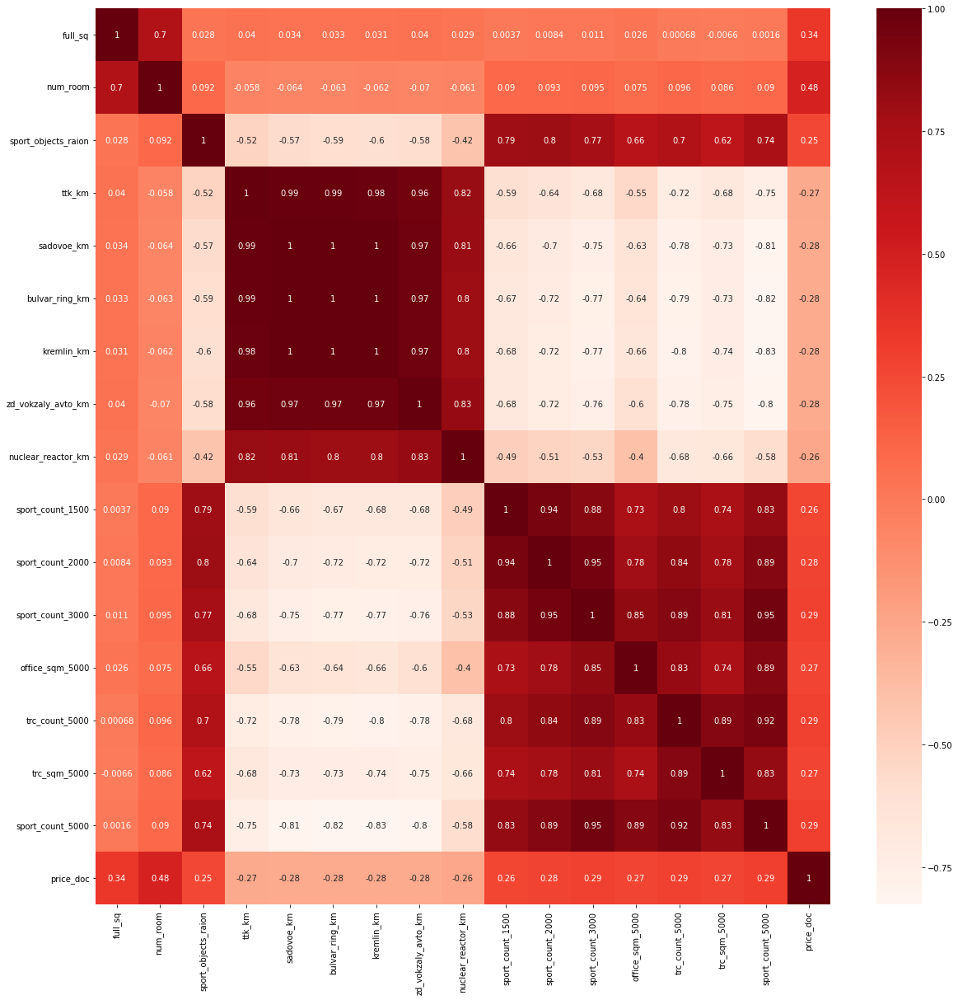

In [31]:
# generate heatmap using Pearson Correlation
plt.figure(figsize=(20,20))
corr = df_train[relevant_fts.index].corr()
sns.heatmap(corr, annot=True, cmap=plt.cm.Reds)
plt.show()

**Conclusion:**

- The first set of features that are highly correlated to each other are: ttk_km, sadovoe_km, bulvar_ring_km, kremlin_km, zd_vokzaly_avto_km, nuclear_reactor_km.

- The second set of features that are highly correlated to each other are: sport_count_1500, sport_count_2000, sport_count_3000, office_sqm_5000,trc_count_5000, trc_sqm_5000, sport_count_5000.

- Thus, we can keep any 1 feature from each of these set and discard the others.

- Also, keep in mind that full_sq & num_room are highly correlated with price_doc with corr = 0.34 and 0.48 respectively.

#### Part 2: Analyze features with correlation values 0.20 <= corr < 0.25 w.r.t. price

In [32]:
target_corr = abs(corr_vals["price_doc"])
relevant_fts = target_corr[(target_corr >= 0.20) & (target_corr < 0.25)]
print("Number of relevant features in this range: {}".format(len(relevant_fts)))
print(relevant_fts)

Number of relevant features in this range: 26
thermal_power_plant_km       0.21
swim_pool_km                 0.21
stadium_km                   0.24
basketball_km                0.22
detention_facility_km        0.22
university_km                0.22
workplaces_km                0.21
office_km                    0.22
theater_km                   0.22
exhibition_km                0.21
catering_km                  0.21
office_sqm_2000              0.22
office_sqm_3000              0.23
trc_count_3000               0.24
trc_sqm_3000                 0.23
office_count_5000            0.22
cafe_count_5000              0.23
cafe_count_5000_na_price     0.23
cafe_count_5000_price_500    0.23
cafe_count_5000_price_1000   0.24
cafe_count_5000_price_1500   0.23
cafe_count_5000_price_2500   0.23
cafe_count_5000_price_4000   0.21
cafe_count_5000_price_high   0.21
church_count_5000            0.21
leisure_count_5000           0.20
Name: price_doc, dtype: float64


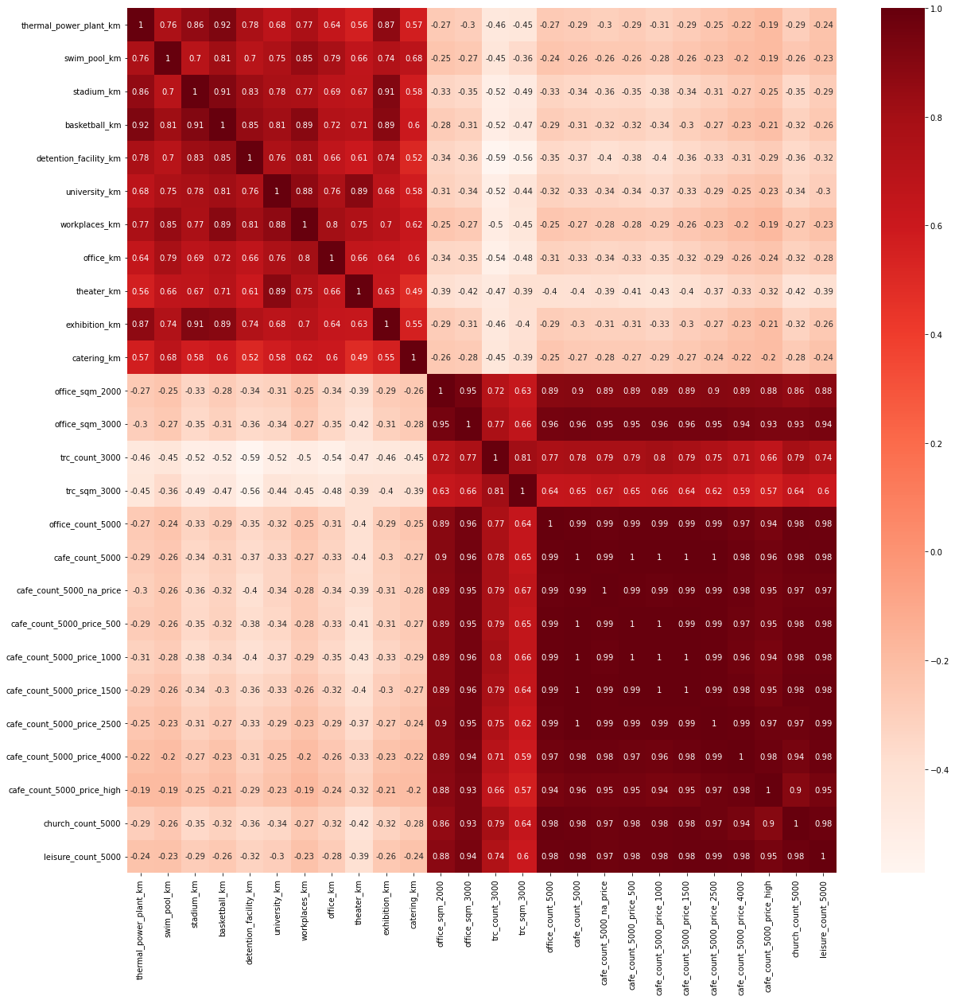

In [33]:
# generate heatmap using Pearson Correlation
plt.figure(figsize=(20,20))
corr = df_train[relevant_fts.index].corr()
sns.heatmap(corr, annot=True, cmap=plt.cm.Reds)
plt.show()

**Conclusion:**

- The first set of features that are highly correlated to each other are: thermal_power_plant_km, swim_pool_km, stadium_km, basketball_km, detention_facility_km, university_km, workplaces_km, office_km, theater_km, exhibition_km, catering_km.

- The second set of features that are highly correlated to each other are: office_sqm_2000, office_sqm_3000, trc_count_3000, trc_sqm_3000, office_count_5000, cafe_count_5000, cafe_count_5000_na_price, cafe_count_5000_price_500, cafe_count_5000_price_1000, cafe_count_5000_price_1500, cafe_count_5000_price_2500, cafe_count_5000_price_4000, cafe_count_5000_price_high, church_count_5000, leisure_count_5000.

- Thus, we can keep any 1 feature from each of these set and discard the others.

#### Part 3: Analyze features with correlation values 0.15 <= corr < 0.20 w.r.t. price

In [34]:
target_corr = abs(corr_vals["price_doc"])
relevant_fts = target_corr[(target_corr >= 0.15) & (target_corr < 0.20)]
print("Number of relevant features in this range: {}".format(len(relevant_fts)))
print(relevant_fts)

Number of relevant features in this range: 53
life_sq                             0.17
area_m                              0.17
raion_popul                         0.15
preschool_education_centers_raion   0.16
school_education_centers_raion      0.19
healthcare_centers_raion            0.19
university_top_20_raion             0.17
shopping_centers_raion              0.15
ekder_all                           0.17
ekder_male                          0.18
ekder_female                        0.17
build_count_brick                   0.17
metro_min_avto                      0.19
metro_km_avto                       0.18
metro_min_walk                      0.18
metro_km_walk                       0.18
park_km                             0.19
big_road2_km                        0.16
bus_terminal_avto_km                0.16
radiation_km                        0.19
power_transmission_line_km          0.16
ts_km                               0.16
market_shop_km                      0.17
fitness_km 

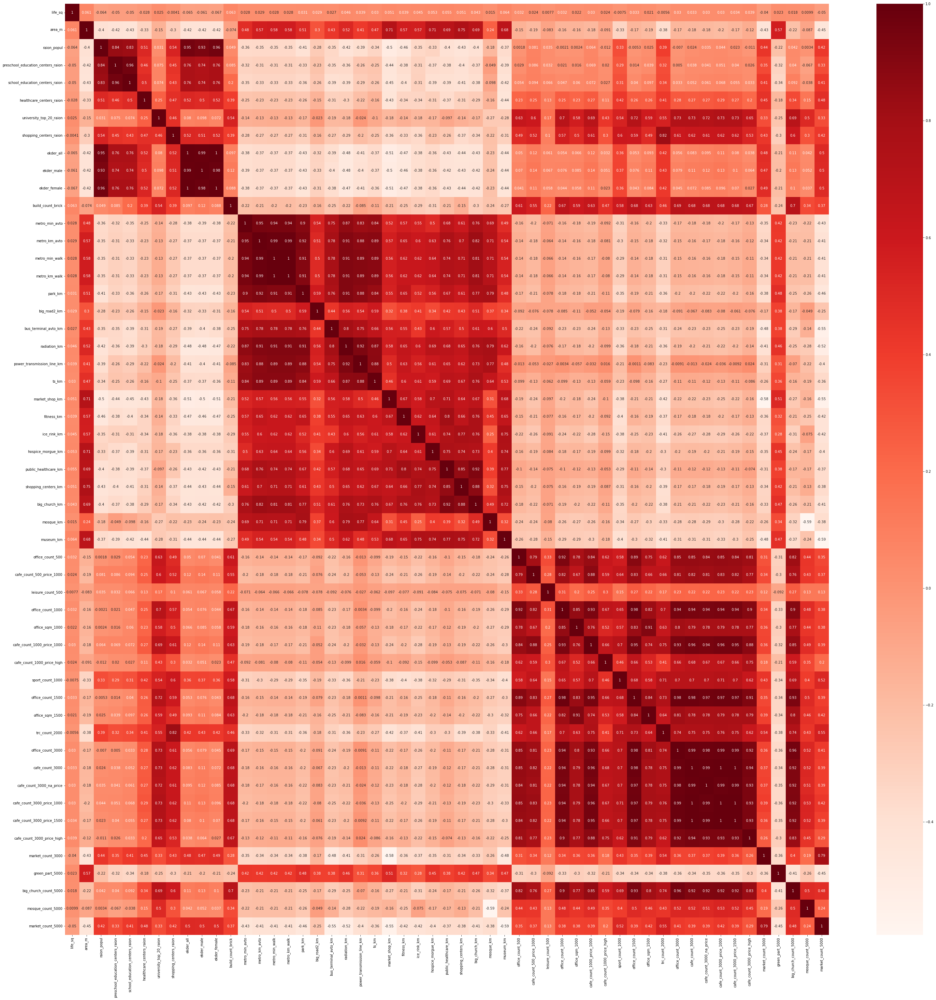

In [35]:
# generate heatmap using Pearson Correlation
plt.figure(figsize=(50, 50))
corr = df_train[relevant_fts.index].corr()
sns.heatmap(corr, annot=True, cmap=plt.cm.Reds)
plt.show()

**Conclusion:**

- The first set of features that are highly correlated to each other are: 

- The second set of features that are highly correlated to each other are: 
- Thus, we can keep any 1 feature from each of these set and discard the others.

#### Part 4: Analyze features with correlation values 0.10 <= corr < 0.15 w.r.t. price

In [36]:
target_corr = abs(corr_vals["price_doc"])
relevant_fts = target_corr[(target_corr >= 0.10) & (target_corr < 0.15)]
print("Number of relevant features in this range: {}".format(len(relevant_fts)))
print(relevant_fts)

Number of relevant features in this range: 81
id                                      0.12
floor                                   0.12
state                                   0.12
children_preschool                      0.13
children_school                         0.14
school_education_centers_top_20_raion   0.10
hospital_beds_raion                     0.15
office_raion                            0.15
young_all                               0.14
young_male                              0.14
young_female                            0.14
work_all                                0.14
work_male                               0.15
work_female                             0.14
0_6_all                                 0.13
0_6_male                                0.13
0_6_female                              0.13
7_14_all                                0.14
7_14_male                               0.14
7_14_female                             0.14
0_17_all                                0.14
0_17_male

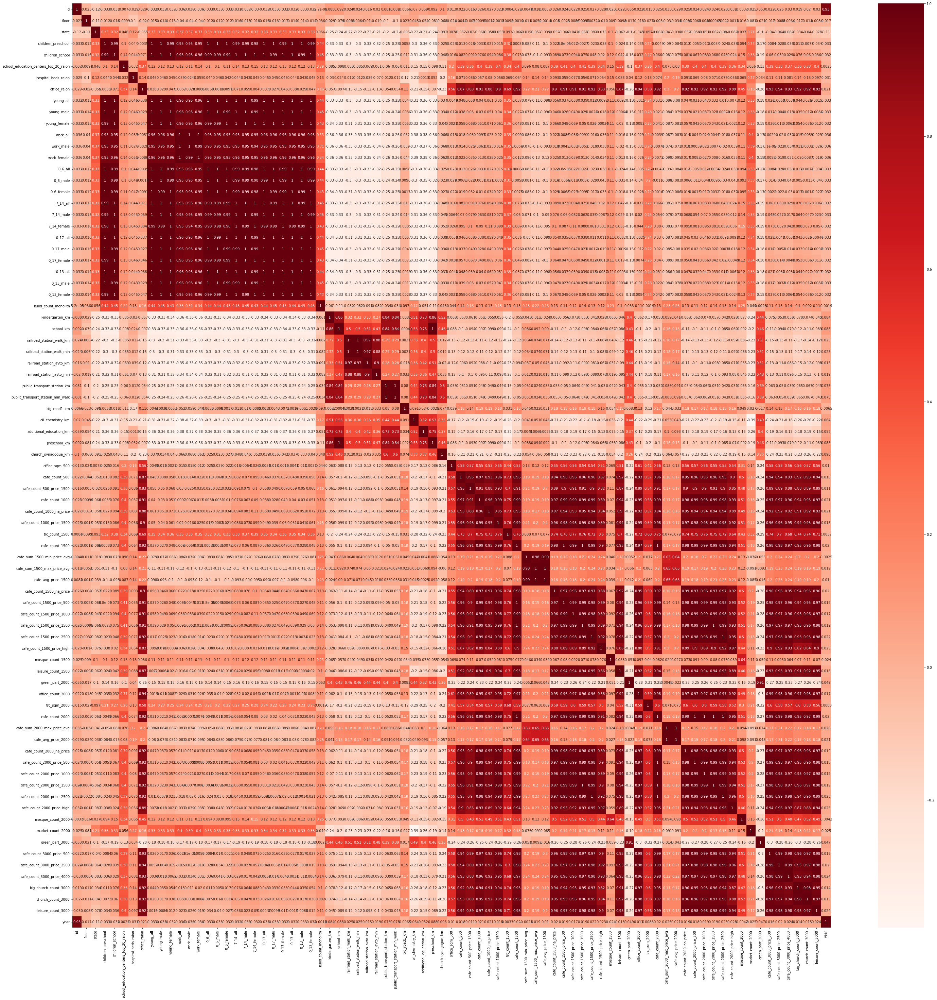

In [37]:
# generate heatmap using Pearson Correlation
plt.figure(figsize=(50, 50))
corr = df_train[relevant_fts.index].corr()
sns.heatmap(corr, annot=True, cmap=plt.cm.Reds)
plt.show()

**Conclusion:**

Features with high correlation to each other:

- children_preschool, children_school.

- young_all, young_male, young_female, work_all,work_male, work_female, 0_6_all, 0_6_male, 0_6_female, 7_14_all, 7_14_male, 7_14_female, 0_17_all, 0_17_male,0_17_female, 0_13_all, 0_13_male, 0_13_female

- railroad_station_walk_km, railroad_station_walk_min,railroad_station_avto_km, railroad_station_avto_min.

- public_transport_station_km, public_transport_station_min_walk

- cafe_count_500, cafe_count_500_price_1500, cafe_count_1000,cafe_count_1000_na_price, cafe_count_1000_price_1500,trc_count_1500, cafe_count_1500.

- cafe_sum_1500_min_price_avg,cafe_sum_1500_max_price_avg, cafe_avg_price_1500

- cafe_count_1500_na_price, cafe_count_1500_price_500,cafe_count_1500_price_1000, cafe_count_1500_price_1500, cafe_count_1500_price_2500, cafe_count_1500_price_high.

- cafe_count_3000_price_500, cafe_count_3000_price_2500,cafe_count_3000_price_4000, big_church_count_3000, church_count_3000, leisure_count_3000.

**Conclusion:**

- There is the presence of high collinearity between the features in the dataset, and this could potentially affect the performance of the training. Thus, we have analyzed which features to remove by analyzing the correlation via a heat map.

- Since the dataset is large, we have split the correlation matrix into 4 portions to analyze the correlation value ranges w.r.t. price.

- We only look at features with corr > 0.1. This is because features with corr < 0.1 will not be of significance to the model we will be building. Thus, features with corr < 0.1 can be discarded.

### Final Conclusion:

In our Exploratory Data Analysis, we have performed the following: 

- Find out the percentage of missing values in all the features

- Univariate Analysis for `price_doc` target feature

- Bivariate Analysis for different selected features against `price_doc`

- Find out which features have high collinearity.